<a href="https://colab.research.google.com/github/dctime/minecraft-texture-generation/blob/main/sword_diffusion_128.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import torch
import torchvision
import matplotlib.pyplot as plt
import torchvision.datasets as dset
import shutil
import os
import numpy
from PIL import Image
from torchvision import datasets
import torch.nn.functional as F
from torchvision import transforms
from torch.utils.data import DataLoader
from tqdm import tqdm
import numpy as np



In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
shutil.unpack_archive("drive/MyDrive/Minecraft Sword Generator/minecraft_textures.zip", "")

In [4]:

def custom_loader(path):
    with open(path, 'rb') as f:
        image = Image.open(f).convert("RGBA")
        new_image = Image.new("RGBA", image.size, "WHITE")
        new_image.paste(image, mask=image)
        return new_image.convert("RGB")
        # return image
# dataset = datasets.ImageFolder(root="minecraft_textures")
dataset = datasets.ImageFolder(root="minecraft_textures", loader=custom_loader)

IMAGE_CHANNELS = 3

Dataset ImageFolder
    Number of datapoints: 2240
    Root location: minecraft_textures


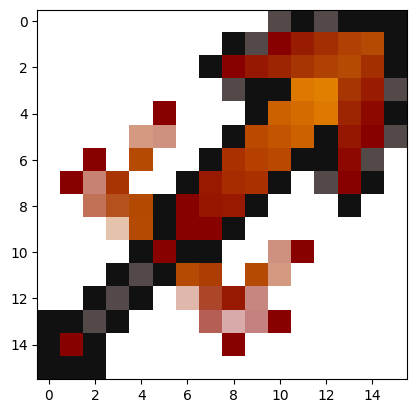

In [5]:
print(dataset)
plt.imshow(dataset[0][0])

Noise the image

In [6]:
def linear_beta_schedule(timesteps, start=0.0001, end=0.06):
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):
    """
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    """
    Takes an image and a timestep as input and
    returns the noisy version of it
    """
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
    + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)


# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

In [7]:
IMG_SIZE = 128
BATCH_SIZE = 16

def load_transformed_dataset():
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE), interpolation=transforms.InterpolationMode.NEAREST),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1]
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ]
    data_transform = transforms.Compose(data_transforms)

    dataset = datasets.ImageFolder(root="minecraft_textures", loader=custom_loader, transform=data_transform)
    # dataset = datasets.ImageFolder(root="minecraft_textures", transform=data_transform)

    return dataset
def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    # Take first image of batch
    if len(image.shape) == 4:
        image = image[0, :, :, :]
    plt.imshow(reverse_transforms(image))

data = load_transformed_dataset()
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

<ipython-input-8-59ea63135d7b>:11: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images+1, int(idx/stepsize) + 1)


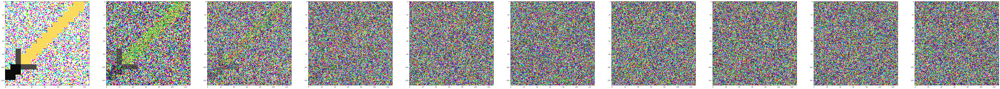

In [8]:
# Simulate forward diffusion
image = next(iter(dataloader))[0]

plt.figure(figsize=(IMG_SIZE, IMG_SIZE))
plt.axis('off')
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, int(idx/stepsize) + 1)
    img, noise = forward_diffusion_sample(image, t)
    show_tensor_image(img)

Denoise Model

In [9]:
from operator import xor
from torch import nn
import math


class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1) # stride = 2 => img size *(2) cuz padding = 1
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1) # stride = 2 => img size *(1/2) cuz padding = 1
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

    def forward(self, x, t, ):
        # print("before:", x.shape)
        # First Conv
        h = self.bnorm1(self.relu(self.conv1(x)))
        # print("step1", h.shape)
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        h = h + time_emb
        # print("step2", h.shape)
        # Second Conv
        h = self.bnorm2(self.relu(self.conv2(h)))
        # Down or Upsample
        # print("step3:", h.shape)
        h = self.transform(h)
        # print("after:", h.shape)
        return h


class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        # TODO: Double check the ordering here
        return embeddings


class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = IMAGE_CHANNELS
        down_channels = (16, 32, 64, 128, 256, 512)
        up_channels = (512, 256, 128, 64, 32, 16)
        out_dim = IMAGE_CHANNELS
        time_emb_dim = 32

        # Time embedding
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim), # input: float output: vector floats -1 to 1
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )

        # Initial projection
        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        # Downsample
        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], time_emb_dim) for i in range(len(down_channels)-1)])
        # Upsample
        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], time_emb_dim, up=True) for i in range(len(up_channels)-1)])

        # Edit: Corrected a bug found by Jakub C (see YouTube comment)
        self.output = nn.Conv2d(up_channels[-1], out_dim, 1)

    def forward(self, x, timestep): # input noised img and timestep
        # Embedd time
        t = self.time_mlp(timestep)
        # Initial conv
        x = self.conv0(x)
        # Unet
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            # print(residual_x.shape, x.shape)
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        return self.output(x)

model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model

Num params:  15687059


SimpleUnet(
  (time_mlp): Sequential(
    (0): SinusoidalPositionEmbeddings()
    (1): Linear(in_features=32, out_features=32, bias=True)
    (2): ReLU()
  )
  (conv0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (downs): ModuleList(
    (0): Block(
      (time_mlp): Linear(in_features=32, out_features=32, bias=True)
      (conv1): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(32, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bnorm1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bnorm2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (1): Block(
      (time_mlp): Linear(in_features=32, out_features=64, bias=True)
      (conv1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(

In [10]:
def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

In [11]:
@torch.no_grad()
def sample_timestep(x, t):
    """
    Calls the model to predict the noise in the image and returns
    the denoised image.
    Applies noise to this image, if we are not in the last step yet.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)

    # Call model (current image - noise prediction)
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)

    if t == 0:
        # As pointed out by Luis Pereira (see YouTube comment)
        # The t's are offset from the t's in the paper
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise

@torch.no_grad()
def sample_plot_image():
    # Sample noise
    img_size = IMG_SIZE
    img = torch.randn((1, IMAGE_CHANNELS, img_size, img_size), device=device)
    plt.figure(figsize=(32,32))
    plt.axis('off')
    num_images = 10
    stepsize = int(T/num_images)

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t)
        # Edit: This is to maintain the natural range of the distribution
        img = torch.clamp(img, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i/stepsize)+1)
            show_tensor_image(img.detach().cpu())
    plt.show()

cuda


  0%|          | 0/100 [00:00<?, ?it/s]

Epoch 0 | step 000 Loss: 0.07940420508384705 


<ipython-input-11-2708988b039a>:44: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, int(i/stepsize)+1)


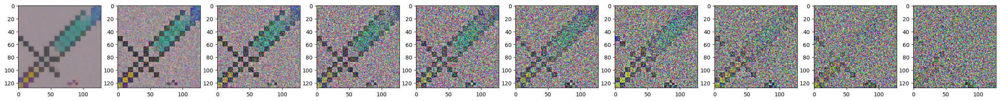

  5%|▌         | 5/100 [00:56<17:09, 10.83s/it]

Epoch 5 | step 000 Loss: 0.045094870030879974 


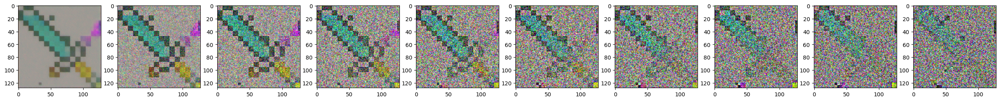

 10%|█         | 10/100 [01:52<16:15, 10.84s/it]

Epoch 10 | step 000 Loss: 0.04755231365561485 


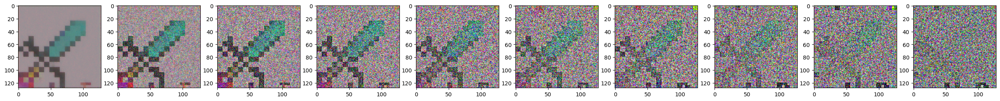

 15%|█▌        | 15/100 [02:50<15:25, 10.89s/it]

Epoch 15 | step 000 Loss: 0.059140145778656006 


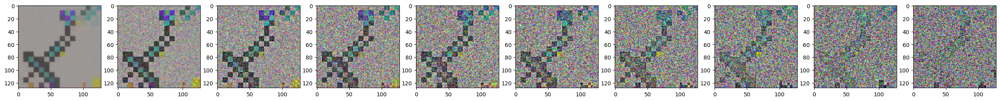

 20%|██        | 20/100 [03:46<14:25, 10.82s/it]

Epoch 20 | step 000 Loss: 0.09098535031080246 


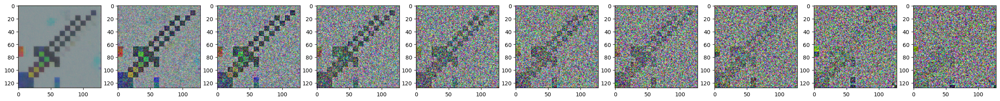

 25%|██▌       | 25/100 [04:42<13:33, 10.84s/it]

Epoch 25 | step 000 Loss: 0.03615309298038483 


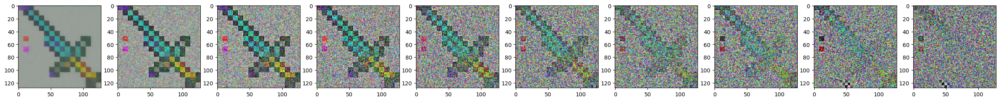

 30%|███       | 30/100 [05:38<12:38, 10.84s/it]

Epoch 30 | step 000 Loss: 0.05306481570005417 


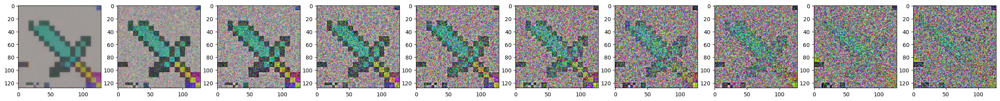

 35%|███▌      | 35/100 [06:35<11:47, 10.88s/it]

Epoch 35 | step 000 Loss: 0.049635812640190125 


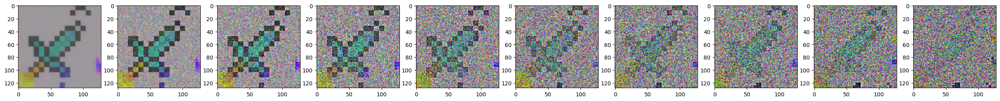

 40%|████      | 40/100 [07:32<10:51, 10.86s/it]

Epoch 40 | step 000 Loss: 0.10595833510160446 


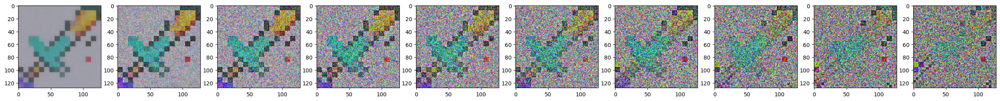

 45%|████▌     | 45/100 [08:29<10:06, 11.03s/it]

Epoch 45 | step 000 Loss: 0.0711626261472702 


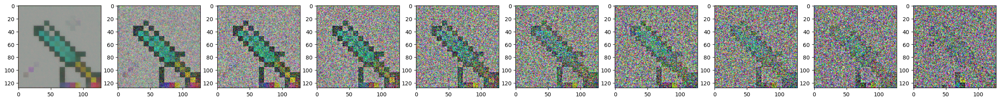

 50%|█████     | 50/100 [09:27<09:08, 10.97s/it]

Epoch 50 | step 000 Loss: 0.09883934259414673 


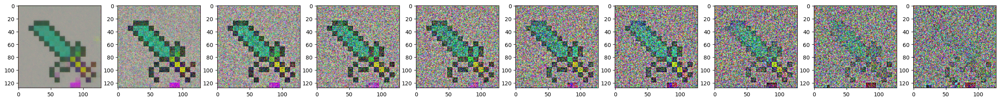

 55%|█████▌    | 55/100 [10:24<08:11, 10.92s/it]

Epoch 55 | step 000 Loss: 0.03581472486257553 


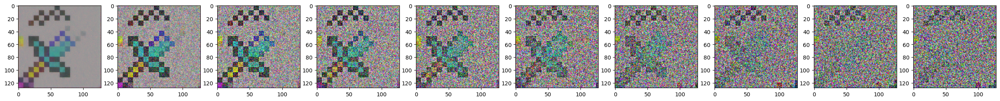

 60%|██████    | 60/100 [11:21<07:17, 10.93s/it]

Epoch 60 | step 000 Loss: 0.09043622016906738 


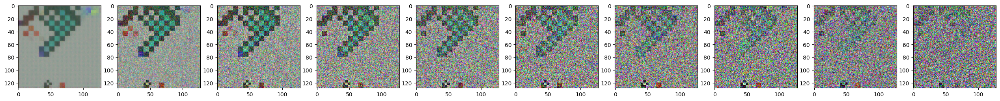

 65%|██████▌   | 65/100 [12:19<06:25, 11.00s/it]

Epoch 65 | step 000 Loss: 0.04100904241204262 


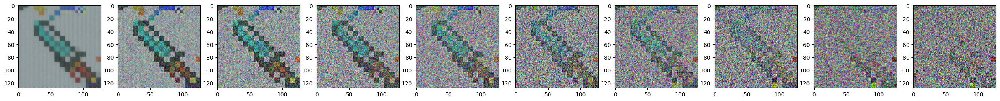

 70%|███████   | 70/100 [13:17<05:28, 10.95s/it]

Epoch 70 | step 000 Loss: 0.060609351843595505 


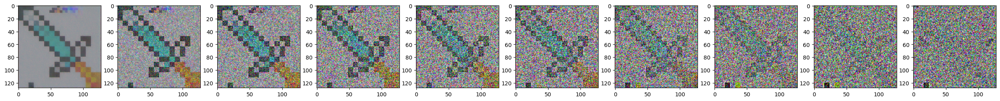

 75%|███████▌  | 75/100 [14:13<04:32, 10.88s/it]

Epoch 75 | step 000 Loss: 0.060502998530864716 


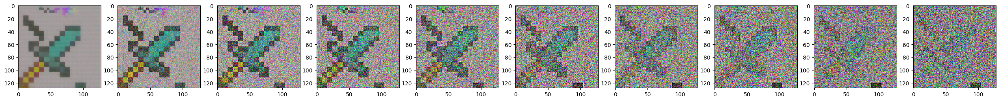

 80%|████████  | 80/100 [15:10<03:37, 10.85s/it]

Epoch 80 | step 000 Loss: 0.11507584899663925 


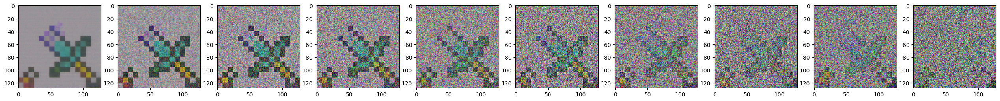

 85%|████████▌ | 85/100 [16:07<02:42, 10.85s/it]

Epoch 85 | step 000 Loss: 0.04788517579436302 


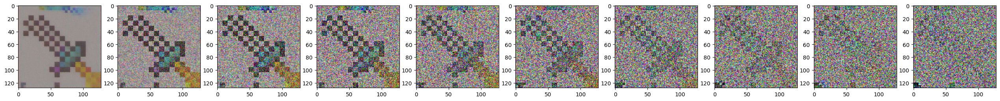

 90%|█████████ | 90/100 [17:04<01:49, 10.92s/it]

Epoch 90 | step 000 Loss: 0.04945604130625725 


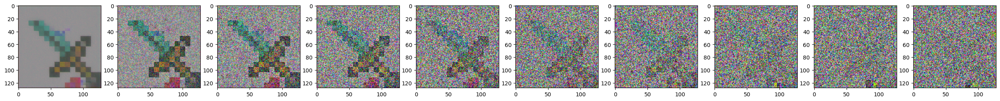

 95%|█████████▌| 95/100 [18:01<00:54, 10.87s/it]

Epoch 95 | step 000 Loss: 0.06466572731733322 


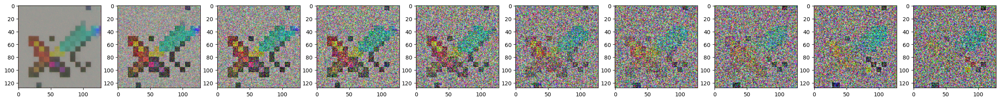

100%|██████████| 100/100 [18:57<00:00, 11.38s/it]


In [24]:
from torch.optim import Adam

device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)
model.to(device)
optimizer = Adam(model.parameters(), lr=0.001)
epochs = 100 # Try more!

for epoch in tqdm(range(epochs)):
    for step, batch in enumerate(dataloader):
      optimizer.zero_grad()

      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model, batch[0], t)
      loss.backward()
      optimizer.step()

      if epoch % 5 == 0 and step == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
        sample_plot_image()

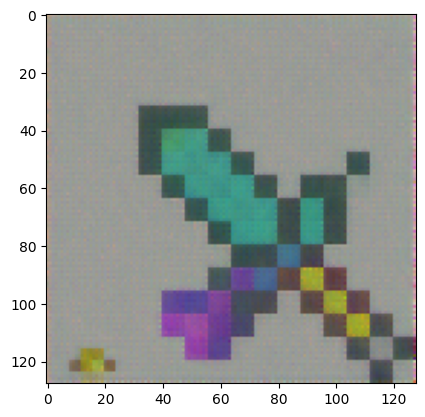

In [35]:
img = torch.randn((1, 3, IMG_SIZE, IMG_SIZE), device=device)

for i in range(0,T)[::-1]:
  t = torch.full((1,), i, device=device, dtype=torch.long)
  img = sample_timestep(img, t)
  img = torch.clamp(img, -1.0, 1.0)

show_tensor_image(img.detach().cpu())

In [23]:
# Save the model
torch.save(model.state_dict(), 'model_128_06.pth')